In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns
import folium
import plotly.express as px
from pylab import *

# **Lecture et présentation des données**

In [2]:
df = pd.read_csv("arbres.csv", encoding = "latin-1",sep=';')

In [3]:
df.head(5)

,id,type_emplacement,domanialite,arrondissement,complement_addresse,numero,lieu,id_emplacement,libelle_francais,genre,espece,variete,circonference_cm,hauteur_m,stade_developpement,remarquable,geo_point_2d_a,geo_point_2d_b
0,99874,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,19,Marronnier,Aesculus,hippocastanum,NaN,20,5,NaN,0.0,48.857620,2.320962
1,99875,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,20,If,Taxus,baccata,NaN,65,8,A,NaN,48.857656,2.321031
2,99876,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,21,If,Taxus,baccata,NaN,90,10,A,NaN,48.857705,2.321061
3,99877,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,22,Erable,Acer,negundo,NaN,60,8,A,NaN,48.857722,2.321006
4,99878,Arbre,Jardin,PARIS 17E ARRDT,NaN,NaN,PARC CLICHY-BATIGNOLLES-MARTIN LUTHER KING,000G0037,Arbre Ã miel,Tetradium,daniellii,NaN,38,0,NaN,NaN,48.890435,2.315289


In [4]:
df.shape

(200137, 18)

In [5]:
df.median()

id                  221078.000000
numero                        NaN
circonference_cm        70.000000
hauteur_m                8.000000
remarquable              0.000000
geo_point_2d_a          48.854162
geo_point_2d_b           2.351095
dtype: float64

In [6]:
df.describe()

,id,numero,circonference_cm,hauteur_m,remarquable,geo_point_2d_a,geo_point_2d_b
count,2.001370e+05,0.0,200137.000000,200137.000000,137039.000000,200137.000000,200137.000000
mean,3.872027e+05,NaN,83.380479,13.110509,0.001343,48.854491,2.348208
std,5.456032e+05,NaN,673.190213,1971.217387,0.036618,0.030234,0.051220
min,9.987400e+04,NaN,0.000000,0.000000,0.000000,48.742290,2.210241
25%,1.559270e+05,NaN,30.000000,5.000000,0.000000,48.835021,2.307530
50%,2.210780e+05,NaN,70.000000,8.000000,0.000000,48.854162,2.351095
75%,2.741020e+05,NaN,115.000000,12.000000,0.000000,48.876447,2.386838
max,2.024745e+06,NaN,250255.000000,881818.000000,1.000000,48.911485,2.469759


In [7]:
df.isnull().sum()

id                          0
type_emplacement            0
domanialite                 1
arrondissement              0
complement_addresse    169235
numero                 200137
lieu                        0
id_emplacement              0
libelle_francais         1497
genre                      16
espece                   1752
variete                163360
circonference_cm            0
hauteur_m                   0
stade_developpement     67205
remarquable             63098
geo_point_2d_a              0
geo_point_2d_b              0
dtype: int64

#### On s'aperçoit qu'il y a beaucoup de valeurs manquantes avec la fonction isnull() et d'autres abérrantes : la valeur max de la hauteur  est de 881818 mètres par exemple ! 

# **Filtrage des données**

### Supression des valeurs abérrantes

#### On supprime toutes les valeurs abérrantes basées sur le fait que l'arbre le plus grand de Paris mesure 30m et le plus gros fait 700cm de circonférence

In [8]:
df=df[df["hauteur_m"]<=35]

In [9]:
df =df[df["circonference_cm"]<=700]

#### On supprime les valeurs hauteur = 0 et circonférence = 0

In [10]:
df=df[df["hauteur_m"]>0.01]

In [11]:
df=df[df["circonference_cm"]>0.01]

### Suppression des valeurs manquantes

#### Supression des colonnes avec trop de valeurs manquantes (<80%)


In [12]:
df = df[df.columns[df.isna().sum()/df.shape[0] < 0.8]]

#### Suppression des valeurs manquantes sur libelle_francais,domanialite,genre et espece

In [13]:
df = df[df['libelle_francais'].notnull()]  

In [14]:
df = df[df['genre'].notnull()]  

In [15]:
df = df[df['espece'].notnull()]  

In [16]:
df = df[df['domanialite'].notnull()]

### On essaye de deviner a quoi correspondent les valeurs de la colonne "stade_developpement"

In [17]:
df.groupby(["stade_developpement"]).mean()

,id,circonference_cm,hauteur_m,remarquable,geo_point_2d_a,geo_point_2d_b
stade_developpement,,,,,,
A,361493.267102,122.877578,13.142497,0.000933,48.856949,2.343394
J,551606.517315,38.946819,5.777846,0.000043,48.851501,2.353515
JA,351228.057122,71.099101,9.077360,0.000034,48.854316,2.343123
M,303345.784204,219.028751,19.159286,0.021390,48.858444,2.345551


###### Le stade "M" correspond aux arbres les plus hauts et à la circonférence la plus élevée, suivi de "A",de "JA" , et de  "J" . On peut en déduire que  "M"=mature, "A"=adulte, "JA"= jeune adulte", "J"= jeune. 

### Le dataset étant maintenant filtré et prêt a l'emploi, on obtient les valeurs suivantes : 

Text(0.5, 1.0, 'La hauteur des arbres de Paris')

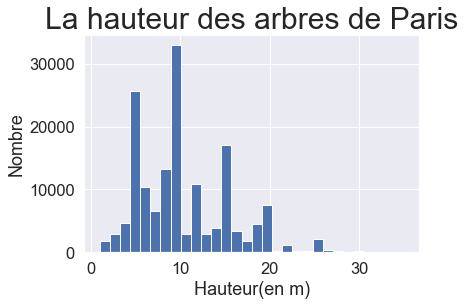

In [18]:
sns.set(font_scale=1.5)
df["hauteur_m"].hist(bins=30)
xlabel("Hauteur(en m)")
ylabel("Nombre")
title("La hauteur des arbres de Paris", size = 30)

#### On s'aperçoit que beaucoup de valeurs sont sur 5, 10, 15 et 20 (surement dût a la non précision de ceux qui prenaient les mesures). Il faut donc lisser 

Text(0.5, 1.0, 'La hauteur des arbres de Paris')

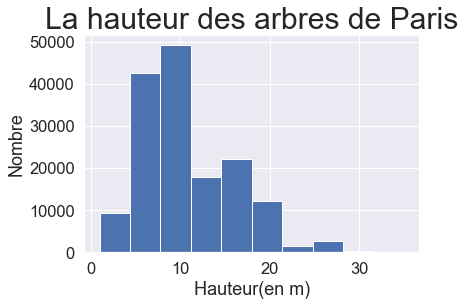

In [19]:
sns.set(font_scale=1.5)
df["hauteur_m"].hist(bins=10)
xlabel("Hauteur(en m)")
ylabel("Nombre")
title("La hauteur des arbres de Paris", size = 30)

Text(0.5, 1.0, 'Distribution statistique des arbres en fonction de la hauteur')

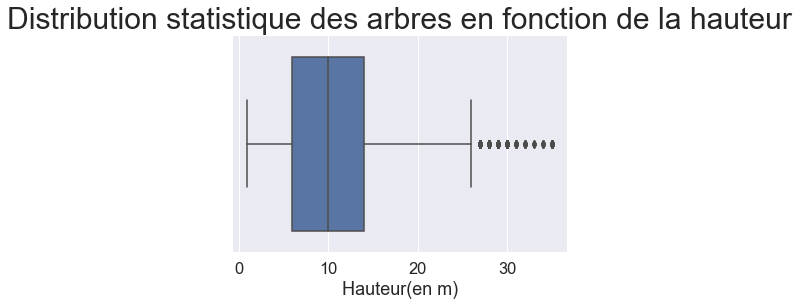

In [20]:
sns.boxplot(x=df["hauteur_m"])
xlabel("Hauteur(en m)")
title("Distribution statistique des arbres en fonction de la hauteur", size = 30)

Text(0.5, 1.0, 'La circonférence des arbres de Paris')

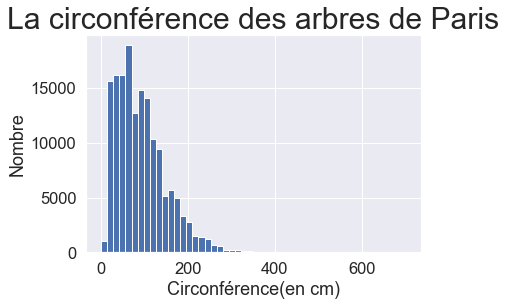

In [21]:
df["circonference_cm"].hist(bins=50)
xlabel("Circonférence(en cm)")
ylabel("Nombre")
title("La circonférence des arbres de Paris", size = 30)

In [22]:
df.shape

(157744, 15)

In [23]:
df.describe()

,id,circonference_cm,hauteur_m,remarquable,geo_point_2d_a,geo_point_2d_b
count,1.577440e+05,157744.000000,157744.000000,125313.000000,157744.000000,157744.000000
mean,3.764003e+05,92.909962,10.400142,0.001420,48.855812,2.346081
std,5.130210e+05,58.914804,5.140344,0.037662,0.025886,0.049379
min,9.987400e+04,1.000000,1.000000,0.000000,48.742290,2.210416
25%,1.870338e+05,50.000000,6.000000,0.000000,48.836797,2.307394
50%,2.326715e+05,80.000000,10.000000,0.000000,48.855182,2.348667
75%,2.766972e+05,125.000000,14.000000,0.000000,48.874041,2.383210
max,2.023468e+06,700.000000,35.000000,1.000000,48.911485,2.469759


In [24]:
df.median()

id                  232671.500000
circonference_cm        80.000000
hauteur_m               10.000000
remarquable              0.000000
geo_point_2d_a          48.855182
geo_point_2d_b           2.348667
dtype: float64

In [25]:
df.isnull().sum()

id                         0
type_emplacement           0
domanialite                0
arrondissement             0
lieu                       0
id_emplacement             0
libelle_francais           0
genre                      0
espece                     0
circonference_cm           0
hauteur_m                  0
stade_developpement    29556
remarquable            32431
geo_point_2d_a             0
geo_point_2d_b             0
dtype: int64

#### on a filtré 42393 valeurs, ce nombre peu paraître grand mais représente en réalité seulement 20% de notre dataset, la réalité de l'analyse qui va suivre n'est donc pas compromise

# **Analyse des données**

## Analyse comparative

### Faisons une carte thermique de corrélation pour voir les différentes données liées entre elles. 
#### Les couleurs claires expriment un lien très fort alors que les couleurs sombres indique qu'il n'y a pas de corrélation. 

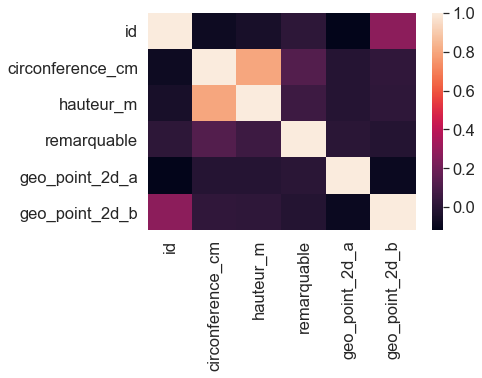

In [26]:
sns.set(font_scale=1.5)
sns.heatmap(df.corr())

#### On s'aperçoit que la hauteur et la circonférence sont très liées, et qu'il n'y a aucun lien entre les autres données. 

### On compte le pourcentage de présence de chaque espèce

In [27]:
df["genre"].value_counts(normalize=True)

Platanus        0.248314
Aesculus        0.144291
Tilia           0.110400
Acer            0.078786
Sophora         0.066107
                  ...   
Carica          0.000006
Brachychiton    0.000006
Callistemon     0.000006
Punica          0.000006
Idesia          0.000006
Name: genre, Length: 145, dtype: float64

### On fait un graphique de la fréquence d'apparition des 10 arbres les plus présents

In [28]:
top_10 = df.groupby(['libelle_francais'])[['libelle_francais']].count().add_suffix('_count').sort_values(by="libelle_francais_count",ascending=False,).reset_index().head(10)

[Text(0, 0.5, 'Espèce'),
 Text(0.5, 0, "Nombre d'arbres"),
 Text(0.5, 1.0, 'Les 10 espèces les plus présentes')]

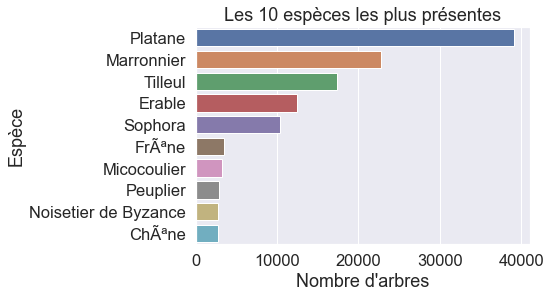

In [29]:
ax = sns.barplot(y="libelle_francais",x="libelle_francais_count",data=top_10)
ax.set(xlabel="Nombre d'arbres", ylabel="Espèce", title="Les 10 espèces les plus présentes")

### On fait un graphique des emplacements les plus communs pour les arbres

In [30]:
separateur = 7000
a = df['domanialite'].value_counts()
doma = a[a > separateur]
doma['Autre'] = a[a <= separateur].sum()

In [31]:
doma = doma/df.shape[0]

Text(0.5, 1.0, 'Emplacement des arbres')

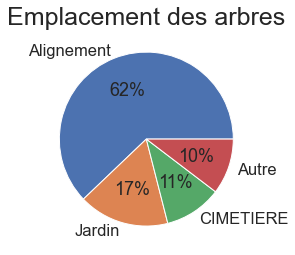

In [32]:
plt.pie(doma,labels=doma.index,autopct='%1.0f%%')
plt.title('Emplacement des arbres',size = 25)

### On prend les valeurs des différents stades de développement des arbres et on en fait un graphique

In [33]:
df["stade_developpement"] = df["stade_developpement"].map({"J":"Jeune","JA":"Jeune adulte","M":"Mature","A":"Adulte"})

In [34]:
develop = df["stade_developpement"].value_counts()

Text(0.5, 1.0, 'Stade de développement des arbres')

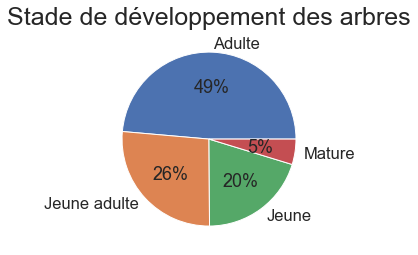

In [35]:
plt.pie(develop, labels = develop.index,autopct='%1.0f%%')
plt.title('Stade de développement des arbres',size = 25)

## Analyse géographique

### on fait une carte de tous les arbres en utilisant les coordonnées GPS 

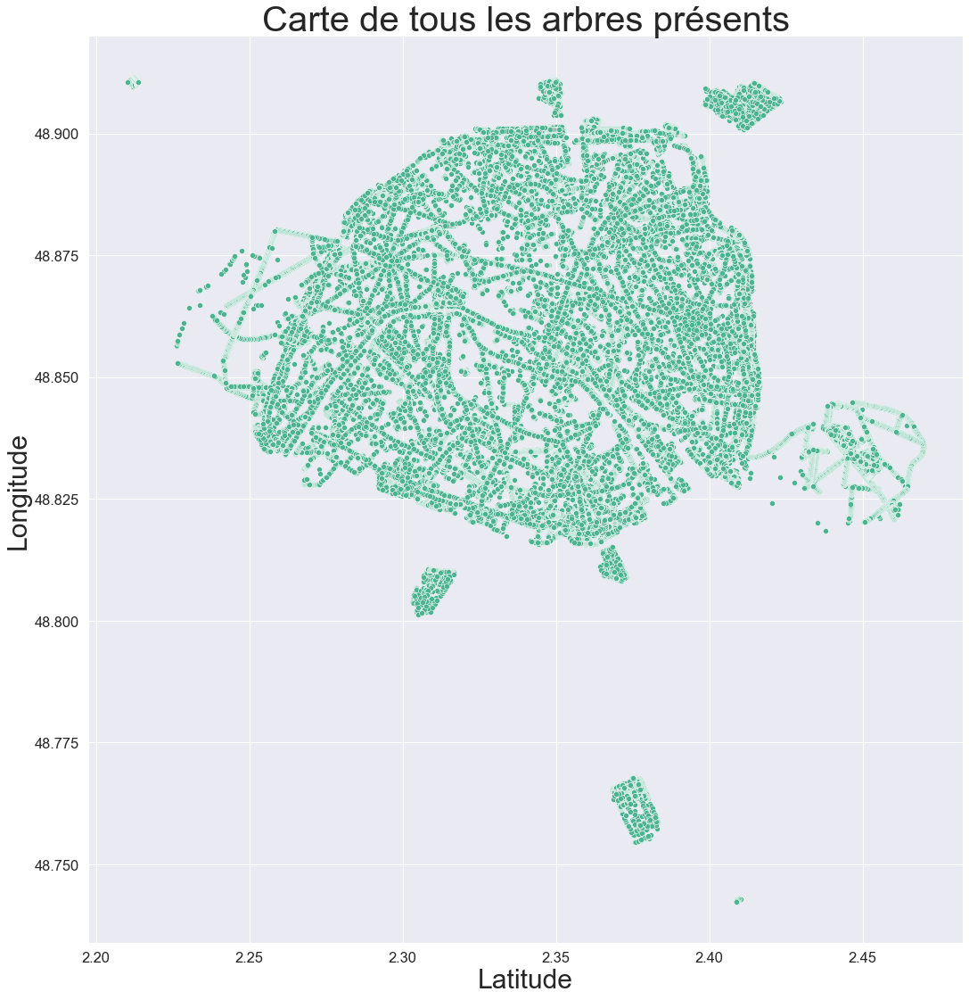

In [36]:
sns.relplot(x=df["geo_point_2d_b"], y=df["geo_point_2d_a"], kind="scatter", color="#4CB391", height=15)
plt.xlabel("Latitude", size=30)
plt.ylabel("Longitude", size=30)
plt.title("Carte de tous les arbres présents", size=40)
sns.set(font_scale=2)

### Ou avec une carte interactive avec 4 catégories basées sur les quartiles : 

In [37]:
def category_size(hauteur_m):
    if hauteur_m <= 6:
        return "Inférieur a 6m"
    elif (hauteur_m > 6.0 ) & (hauteur_m <=10 ):
        return "Entre 6m et 10 m"
    elif (hauteur_m > 10 ) & (hauteur_m <= 14):
             return "Entre 10 m et 14m"
    else:
        return "Supérieur a 14m"

In [38]:
Categorie_hauteur = df["hauteur_m"].map(category_size)

df['Categorie_hauteur'] = Categorie_hauteur

In [39]:
fig = px.scatter_mapbox(df, lat="geo_point_2d_a", lon="geo_point_2d_b", 
                  color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=10.5,color='Categorie_hauteur'
                  ,mapbox_style="carto-positron")
fig.update_layout(
    height=600,
    title_text='Les arbre de Paris classés en fonction de leur taille '
)
fig

#### Il est possible de cliquer sur les catégories pour les faire apparaitre/disparaitre

## Analyse des 3 arbres les plus présents

### On prend les 3 espèces les plus présentes pour afficher leurs emplacements sur une carte

In [40]:
max_3 = df["libelle_francais"].value_counts(normalize=True)[df["libelle_francais"].value_counts(normalize=True)>0.1]

In [41]:
top_3 = df.loc[df["libelle_francais"] == "Platane"]

In [42]:
for i in max_3.index:
   top_3 =top_3.append(df.loc[df["libelle_francais"] == i])

Text(0.5, 1.0, 'Répartition des 3 arbres les plus présents')

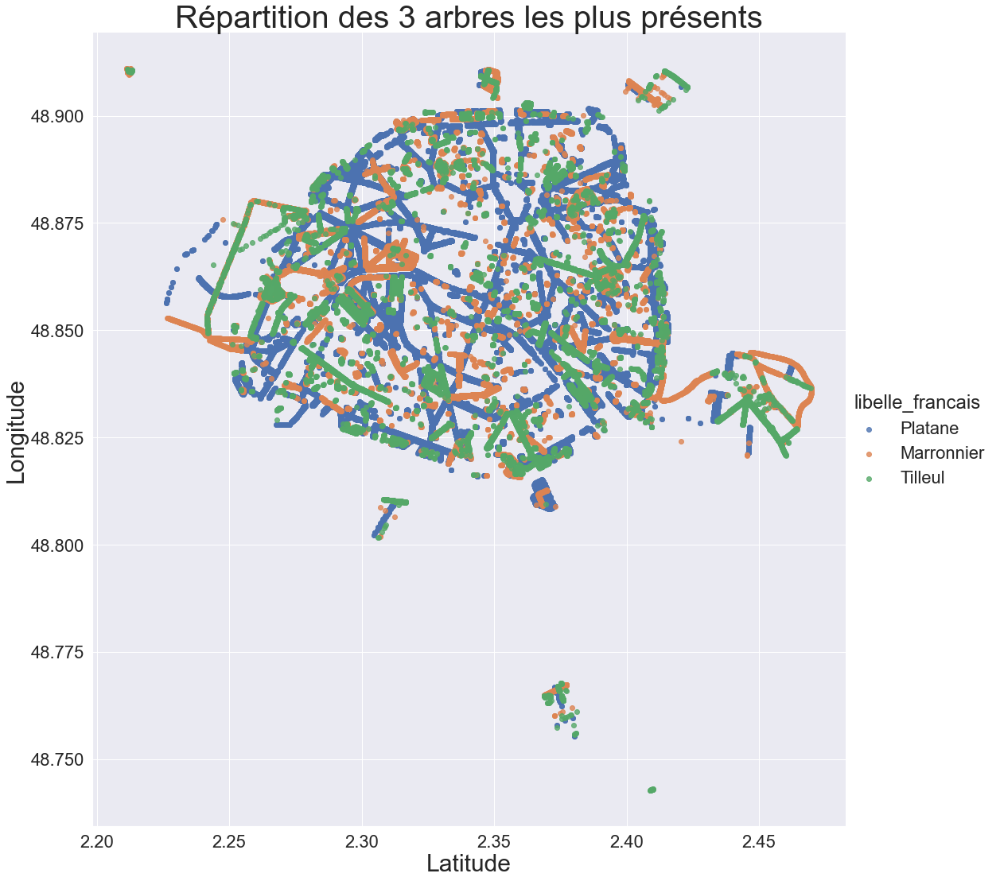

In [43]:
sns.lmplot(y="geo_point_2d_a", x="geo_point_2d_b", hue='libelle_francais', data=top_3, height=15 ,fit_reg=False)
plt.xlabel("Latitude", size=30)
plt.ylabel("Longitude", size=30)
plt.title("Répartition des 3 arbres les plus présents", size=40)


### Ou sur une carte interactive : (il est possible de cliquer sur les catégories pour les faire disparaitre/apparaître ici aussi)

In [44]:
fig = px.scatter_mapbox(top_3, lat="geo_point_2d_a", lon="geo_point_2d_b", 
                  color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=10.5,color='libelle_francais'
                  ,mapbox_style="carto-positron")
fig.update_layout(
    height=600,
    title_text='Les 3 arbres de Paris les plus présents '
)
fig

Text(0.5, 1.0, 'distribution du top 3 des arbres en fonction de leur hauteur')

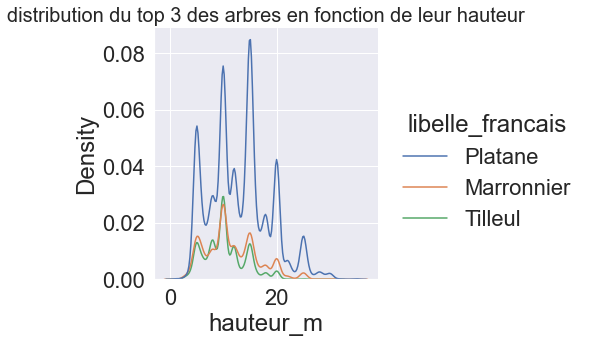

In [45]:
ax = sns.displot(data=top_3, x="hauteur_m", hue="libelle_francais", kind="kde")
plt.title('distribution du top 3 des arbres en fonction de leur hauteur', size = 20)

In [46]:
top_3.loc[np.random.choice(top_3.index, 1000, replace=False)]

,id,type_emplacement,domanialite,arrondissement,lieu,id_emplacement,libelle_francais,genre,espece,circonference_cm,hauteur_m,stade_developpement,remarquable,geo_point_2d_a,geo_point_2d_b,Categorie_hauteur
99050,220035,Arbre,Alignement,PARIS 12E ARRDT,BOULEVARD DE BERCY,202022,Platane,Platanus,x hispanica,110,15,Adulte,0.0,48.839952,2.378836,Supérieur a 14m
99050,220035,Arbre,Alignement,PARIS 12E ARRDT,BOULEVARD DE BERCY,202022,Platane,Platanus,x hispanica,110,15,Adulte,0.0,48.839952,2.378836,Supérieur a 14m
172440,297152,Arbre,Alignement,PARIS 8E ARRDT,AVENUE MATIGNON,301006,Marronnier,Aesculus,x carnea,38,5,Jeune,0.0,48.870214,2.312344,Inférieur a 6m
97515,218441,Arbre,Alignement,PARIS 13E ARRDT,BOULEVARD AUGUSTE BLANQUI,301022,Platane,Platanus,occidentalis,55,10,Jeune,0.0,48.829476,2.349593,Entre 6m et 10 m
97515,218441,Arbre,Alignement,PARIS 13E ARRDT,BOULEVARD AUGUSTE BLANQUI,301022,Platane,Platanus,occidentalis,55,10,Jeune,0.0,48.829476,2.349593,Entre 6m et 10 m
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118818,241810,Arbre,Alignement,PARIS 19E ARRDT,AVENUE SIMON BOLIVAR,301015,Platane,Platanus,orientalis,55,10,Jeune adulte,0.0,48.876165,2.380181,Entre 6m et 10 m
118818,241810,Arbre,Alignement,PARIS 19E ARRDT,AVENUE SIMON BOLIVAR,301015,Platane,Platanus,orientalis,55,10,Jeune adulte,0.0,48.876165,2.380181,Entre 6m et 10 m
159912,284278,Arbre,Alignement,PARIS 18E ARRDT,AVENUE DE SAINT OUEN,2002006,Platane,Platanus,x hispanica,126,18,Adulte,0.0,48.896435,2.328684,Supérieur a 14m
159912,284278,Arbre,Alignement,PARIS 18E ARRDT,AVENUE DE SAINT OUEN,2002006,Platane,Platanus,x hispanica,126,18,Adulte,0.0,48.896435,2.328684,Supérieur a 14m


### Emplacement de tous les arbres remarquables : les arbres qui font partis de la culture de Paris

In [47]:
import folium
remarq=df.loc[df["remarquable"].isin(["1.0"])]

carte_remarquable = folium.Map(location=[48.85, 2.34],zoom_start=12)

for ind, lat, lon in remarq[['geo_point_2d_a', 'geo_point_2d_b']].itertuples():
     folium.Marker([lat,lon],
                              icon=folium.Icon(
                                  icon_color='green',
                                  icon='fa-tree',    
                                  prefix='fa'),
                              ).add_to(carte_remarquable)

carte_remarquable

# Synthèse : l'exemple du lac du Buttes- Chaumont 

### Carte des arbres remarquables au lac du Buttes-Chaumont

In [48]:
remarq=df.loc[df["remarquable"].isin(["1.0"])]

carte_remarquable = folium.Map(location=[48.88125, 2.3827],zoom_start=20)

for ind, lat, lon in remarq[['geo_point_2d_a', 'geo_point_2d_b']].itertuples():
     folium.Marker([lat,lon],
                              icon=folium.Icon(
                                  icon_color='green',
                                  icon='fa-tree',    
                                  prefix='fa'),
                              ).add_to(carte_remarquable)

carte_remarquable

In [49]:
fig = px.scatter_mapbox(df, lat="geo_point_2d_a", lon="geo_point_2d_b", 
                  color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=10.5,color='Categorie_hauteur'
                  ,mapbox_style="carto-positron")
fig.update_layout(
    height=600,
    title_text='Les arbre de Paris classés en fonction de leur taille '
)
fig